## Clone Tensorflow Models Repository

In [ ]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 81557, done.
remote: Counting objects: 100% (26/26), done.
remote: Compressing objects: 100% (19/19), done.
remote: Total 81557 (delta 16), reused 14 (delta 7), pack-reused 81531
Receiving objects: 100% (81557/81557), 596.12 MiB | 21.63 MiB/s, done.
Resolving deltas: 100% (58213/58213), done.


In [ ]:
!cd models/research/ && protoc object_detection/protos/*.proto --python_out=.

## Install the object detection API

In [ ]:
!cd models/research && \
    cp object_detection/packages/tf2/setup.py . && \
    python -m pip install .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.6/14.6 MB 93.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 352.1/352.1 KB 29.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 72.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 43.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.6/116.6 KB 13.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 62.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.8/5.8 MB 108.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 662.4/662.4 KB 51.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 238.9/238.9 KB 2

## Import Libraries

In [ ]:
import os
import pathlib
import tensorflow as tf

import time
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

%matplotlib inline

In [ ]:
# Enable GPU dynamic memory allocation
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

## UNZIPPING Images

In [ ]:
!unzip "/content/archive (1).zip"

Archive:  /content/archive (1).zip
  inflating: data/sample_submission.csv  
  inflating: data/testing_images/vid_5_25100.jpg  
  inflating: data/testing_images/vid_5_25120.jpg  
  inflating: data/testing_images/vid_5_25140.jpg  
  inflating: data/testing_images/vid_5_25160.jpg  
  inflating: data/testing_images/vid_5_25180.jpg  
  inflating: data/testing_images/vid_5_25200.jpg  
  inflating: data/testing_images/vid_5_25220.jpg  
  inflating: data/testing_images/vid_5_25240.jpg  
  inflating: data/testing_images/vid_5_25260.jpg  
  inflating: data/testing_images/vid_5_26320.jpg  
  inflating: data/testing_images/vid_5_26400.jpg  
  inflating: data/testing_images/vid_5_26420.jpg  
  inflating: data/testing_images/vid_5_26560.jpg  
  inflating: data/testing_images/vid_5_26580.jpg  
  inflating: data/testing_images/vid_5_26600.jpg  
  inflating: data/testing_images/vid_5_26620.jpg  
  inflating: data/testing_images/vid_5_26640.jpg  
  inflating: data/testing_images/vid_5_26660.jpg  
  inf

In [ ]:
!ls

'archive (1).zip'   archive.zip   data	 models   sample_data


In [ ]:
IMAGE_PATHS = []
for dirname, _, filenames in os.walk('/content/data/testing_images'):
    for filename in filenames:
        IMAGE_PATHS.append((os.path.join(dirname, filename)))
IMAGE_PATHS

['/content/data/testing_images/vid_5_31360.jpg',
 '/content/data/testing_images/vid_5_29520.jpg',
 '/content/data/testing_images/vid_5_30000.jpg',
 '/content/data/testing_images/vid_5_27600.jpg',
 '/content/data/testing_images/vid_5_31020.jpg',
 '/content/data/testing_images/vid_5_31300.jpg',
 '/content/data/testing_images/vid_5_29060.jpg',
 '/content/data/testing_images/vid_5_30940.jpg',
 '/content/data/testing_images/vid_5_31520.jpg',
 '/content/data/testing_images/vid_5_28540.jpg',
 '/content/data/testing_images/vid_5_31600.jpg',
 '/content/data/testing_images/vid_5_29500.jpg',
 '/content/data/testing_images/vid_5_26800.jpg',
 '/content/data/testing_images/vid_5_28360.jpg',
 '/content/data/testing_images/vid_5_31060.jpg',
 '/content/data/testing_images/vid_5_29100.jpg',
 '/content/data/testing_images/vid_5_27920.jpg',
 '/content/data/testing_images/vid_5_27800.jpg',
 '/content/data/testing_images/vid_5_29000.jpg',
 '/content/data/testing_images/vid_5_28660.jpg',
 '/content/data/test

## Download and extract model files

Get URLs from the "Object Detection Zoo": https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md

In [ ]:
url = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet101_v1_fpn_640x640_coco17_tpu-8.tar.gz'

PATH_TO_MODEL_DIR = tf.keras.utils.get_file(
    fname='ssd_resnet101_v1_fpn_640x640_coco17_tpu-8',
    origin=url,
    untar=True)

386527459/386527459 [==============================] - 2s 0us/step


In [ ]:
PATH_TO_MODEL_DIR

'/root/.keras/datasets/ssd_resnet101_v1_fpn_640x640_coco17_tpu-8'

## Download Labels File

Label files can be found here: https://github.com/tensorflow/models/tree/master/research/object_detection/data

You probably won't need these since Object Detection Zoo contains only models trained on COCO.

In [ ]:
url = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/data/mscoco_label_map.pbtxt'

PATH_TO_LABELS = tf.keras.utils.get_file(
    fname='mscoco_label_map.pbtxt',
    origin=url,
    untar=False)

5056/5056 [==============================] - 0s 0us/step


In [ ]:
PATH_TO_LABELS

'/root/.keras/datasets/mscoco_label_map.pbtxt'

In [ ]:
!head {PATH_TO_LABELS}

item {
  name: "/m/01g317"
  id: 1
  display_name: "person"
}
item {
  name: "/m/0199g"
  id: 2
  display_name: "bicycle"
}


## Load in the model

In [ ]:
PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"

print('Loading model...', end='')
start_time = time.time()

# Load saved model and build the detection function
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)

end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

Loading model...Done! Took 27.223838567733765 seconds


## Load in the labels

In [ ]:
category_index = label_map_util.create_category_index_from_labelmap(
    PATH_TO_LABELS,
    use_display_name=True)

In [ ]:
category_index

{1: {'id': 1, 'name': 'person'},
 2: {'id': 2, 'name': 'bicycle'},
 3: {'id': 3, 'name': 'car'},
 4: {'id': 4, 'name': 'motorcycle'},
 5: {'id': 5, 'name': 'airplane'},
 6: {'id': 6, 'name': 'bus'},
 7: {'id': 7, 'name': 'train'},
 8: {'id': 8, 'name': 'truck'},
 9: {'id': 9, 'name': 'boat'},
 10: {'id': 10, 'name': 'traffic light'},
 11: {'id': 11, 'name': 'fire hydrant'},
 13: {'id': 13, 'name': 'stop sign'},
 14: {'id': 14, 'name': 'parking meter'},
 15: {'id': 15, 'name': 'bench'},
 16: {'id': 16, 'name': 'bird'},
 17: {'id': 17, 'name': 'cat'},
 18: {'id': 18, 'name': 'dog'},
 19: {'id': 19, 'name': 'horse'},
 20: {'id': 20, 'name': 'sheep'},
 21: {'id': 21, 'name': 'cow'},
 22: {'id': 22, 'name': 'elephant'},
 23: {'id': 23, 'name': 'bear'},
 24: {'id': 24, 'name': 'zebra'},
 25: {'id': 25, 'name': 'giraffe'},
 27: {'id': 27, 'name': 'backpack'},
 28: {'id': 28, 'name': 'umbrella'},
 31: {'id': 31, 'name': 'handbag'},
 32: {'id': 32, 'name': 'tie'},
 33: {'id': 33, 'name': 'suitc

## Helper function

In [ ]:
## Helper function

def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.

    Puts image into numpy array to feed into tensorflow graph.
    Note that by convention we put it into a numpy array with shape
    (height, width, channels), where channels=3 for RGB.

    Args:
      path: the file path to the image

    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(Image.open(path))

## Do some object detection

In [ ]:
def detect_objects(image_path):
    print('Running inference for {}... '.format(image_path), end='')

    image_np = load_image_into_numpy_array(image_path)

    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(image_np)

    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis, ...]

    # Do the detection
    detections = detect_fn(input_tensor)

    # All outputs are batches tensors.
    # Convert to numpy arrays, and take index [0] to remove the batch dimension.
    # We're only interested in the first num_detections.
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                   for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    # show classes
    # unique_classes = set(detections['detection_classes'])
    # print("Classes found:")
    # for c in unique_classes:
    #     print(category_index[c]['name'])

    image_np_with_detections = image_np.copy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
          image_np_with_detections,
          detections['detection_boxes'],
          detections['detection_classes'],
          detections['detection_scores'],
          category_index,
          use_normalized_coordinates=True,
          max_boxes_to_draw=200,
          min_score_thresh=.30,
          agnostic_mode=False)

    plt.figure(figsize=(15, 10))
    plt.imshow(image_np_with_detections)
    print('Done')
    plt.show()

Running inference for /content/data/testing_images/vid_5_31360.jpg... Done


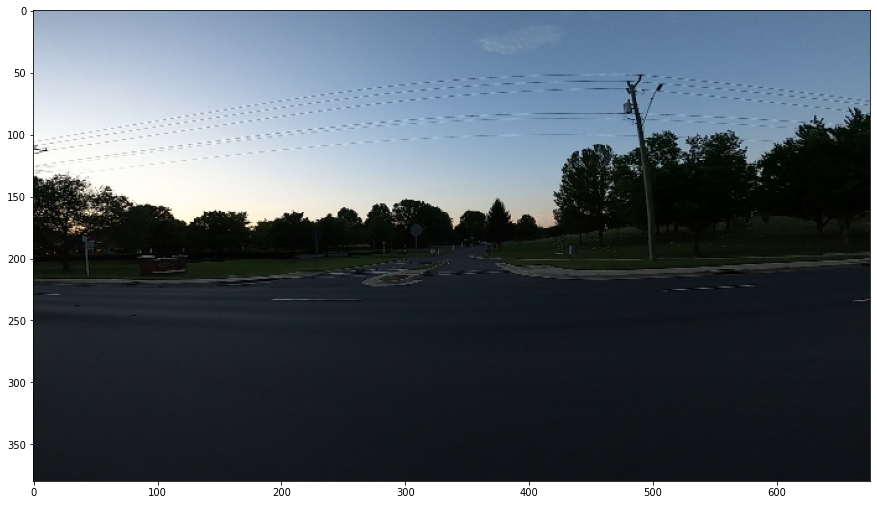

In [ ]:
detect_objects(IMAGE_PATHS[0])

Running inference for /content/data/testing_images/vid_5_29520.jpg... Done


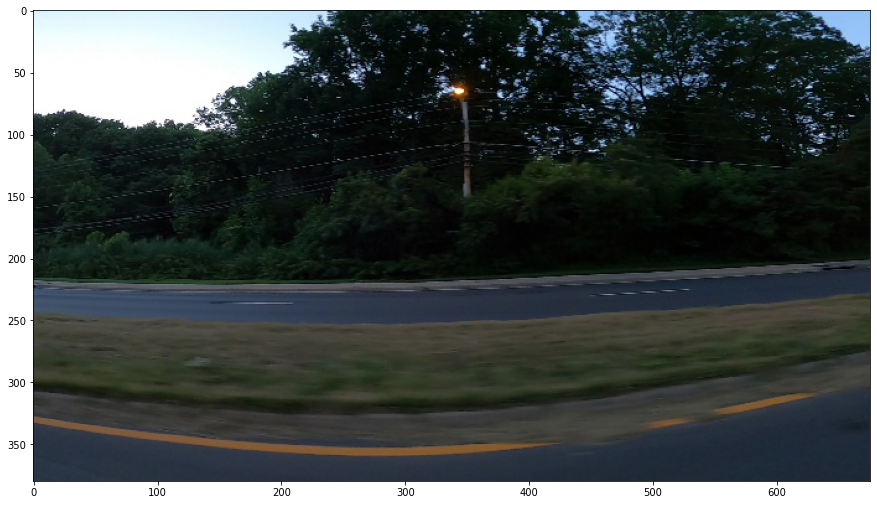

In [ ]:
detect_objects(IMAGE_PATHS[1])

Running inference for /content/data/testing_images/vid_5_30000.jpg... Done


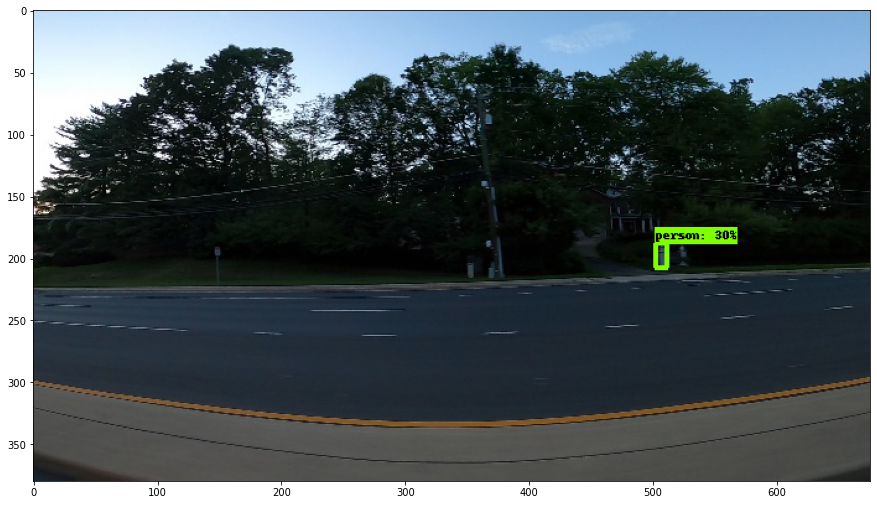

In [ ]:
detect_objects(IMAGE_PATHS[2])

Running inference for /content/data/testing_images/vid_5_27600.jpg... Done


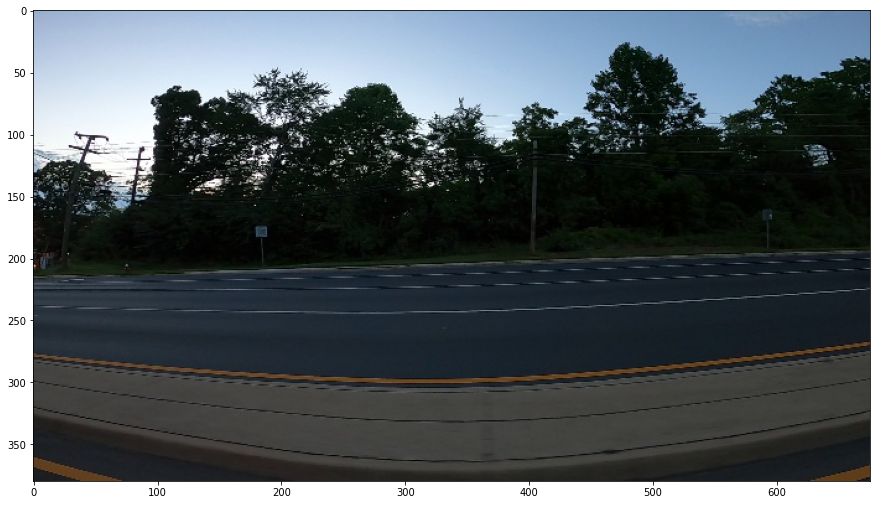

In [ ]:
detect_objects(IMAGE_PATHS[3])

Running inference for /content/data/testing_images/vid_5_27780.jpg... Done


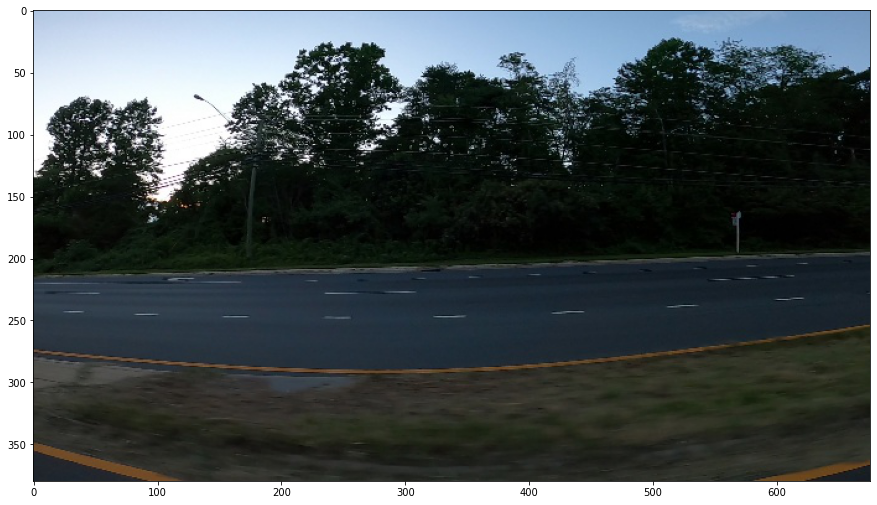

Running inference for /content/data/testing_images/vid_5_29580.jpg... Done


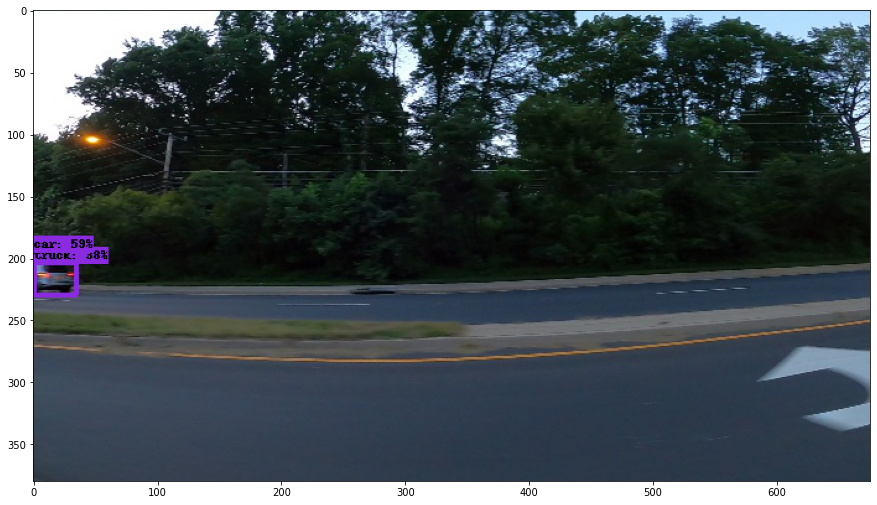

Running inference for /content/data/testing_images/vid_5_27700.jpg... Done


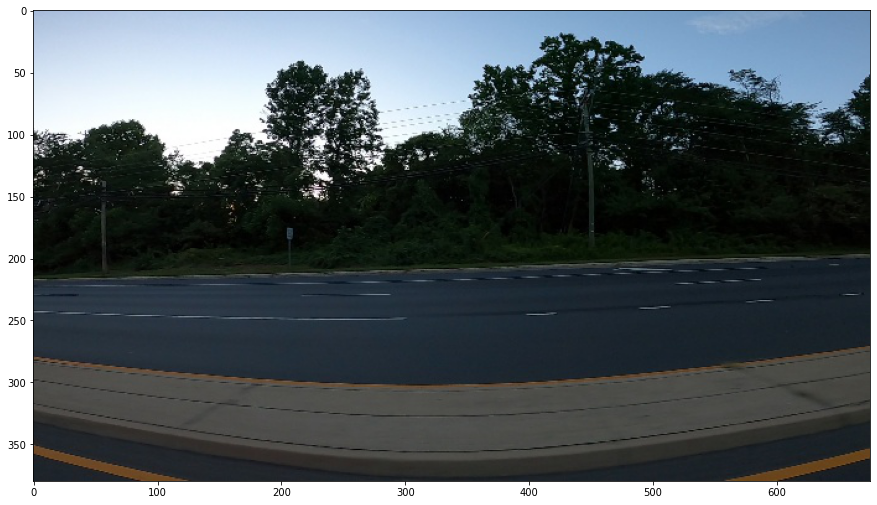

Running inference for /content/data/testing_images/vid_5_29460.jpg... Done


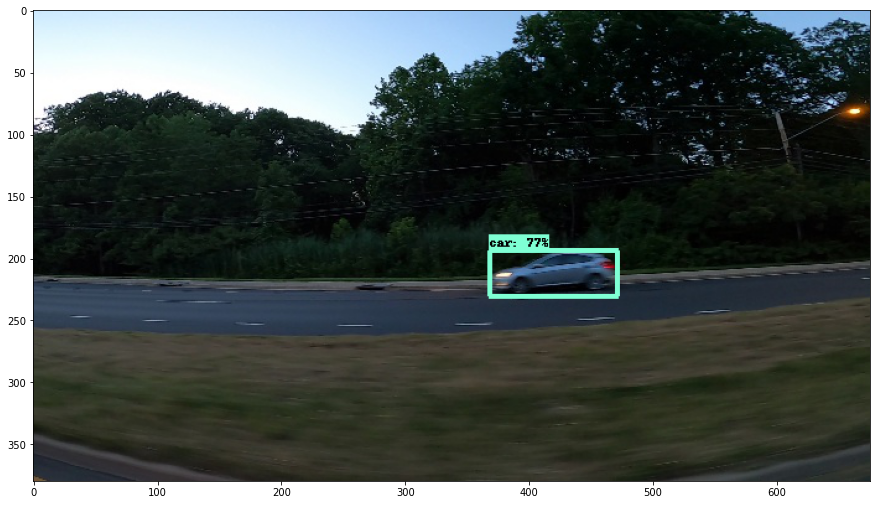

Running inference for /content/data/testing_images/vid_5_26680.jpg... Done


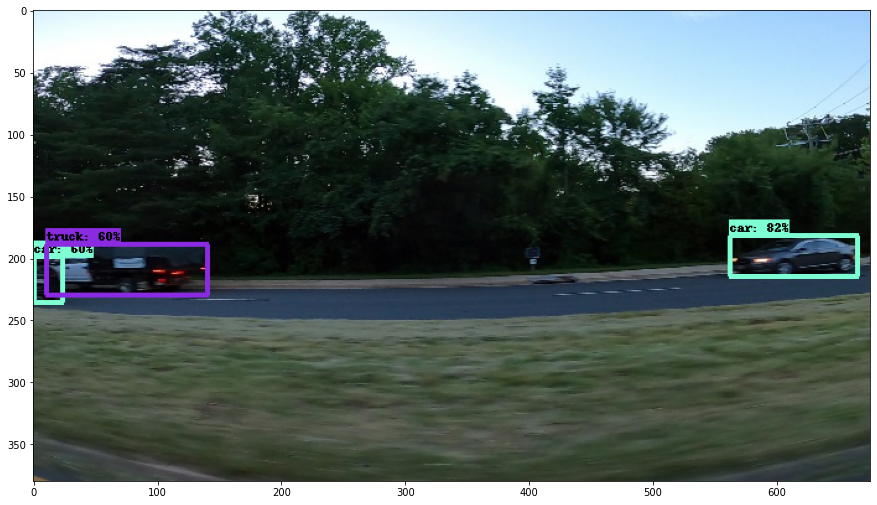

Running inference for /content/data/testing_images/vid_5_29500.jpg... Done


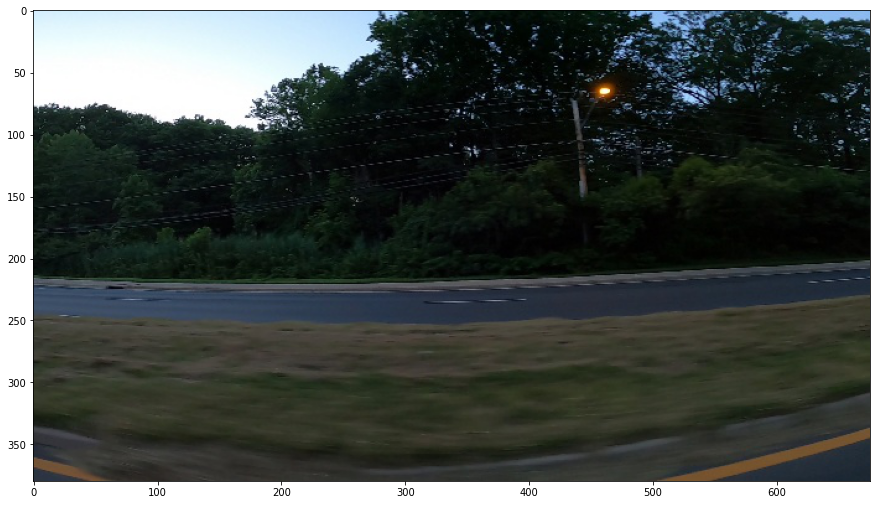

Running inference for /content/data/testing_images/vid_5_27260.jpg... Done


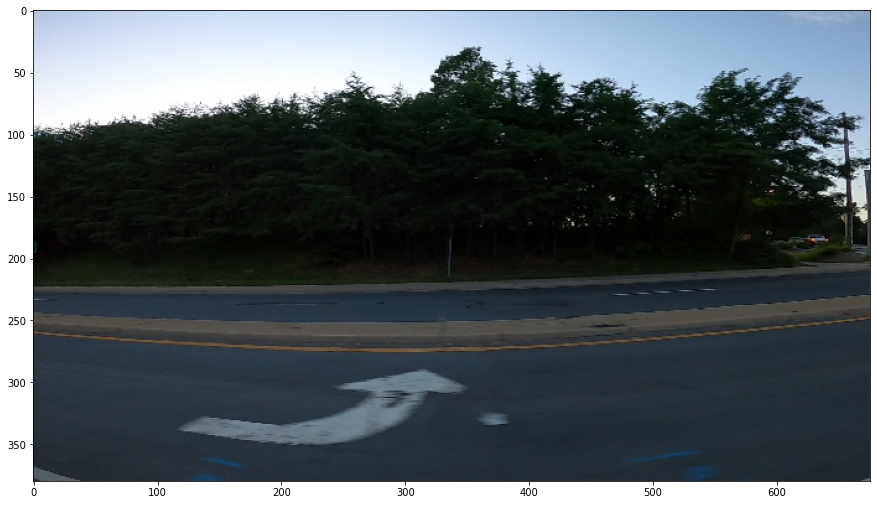

Running inference for /content/data/testing_images/vid_5_28060.jpg... Done


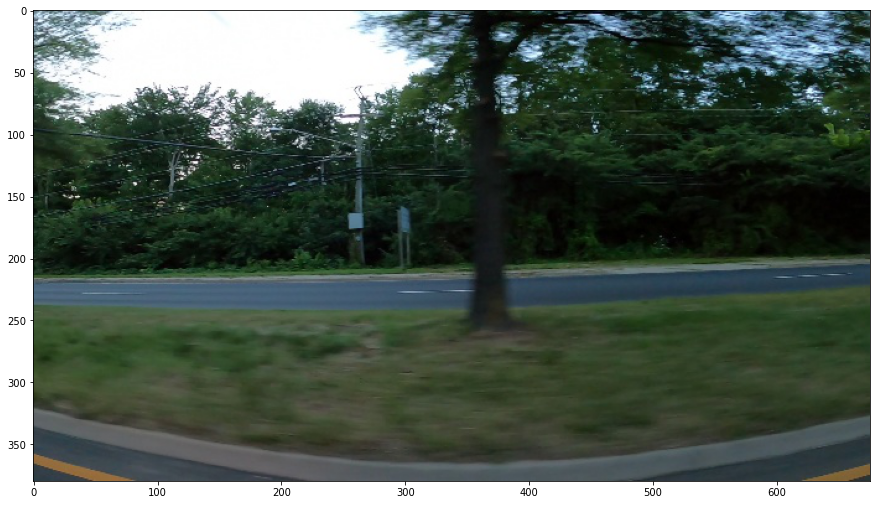

Running inference for /content/data/testing_images/vid_5_28020.jpg... Done


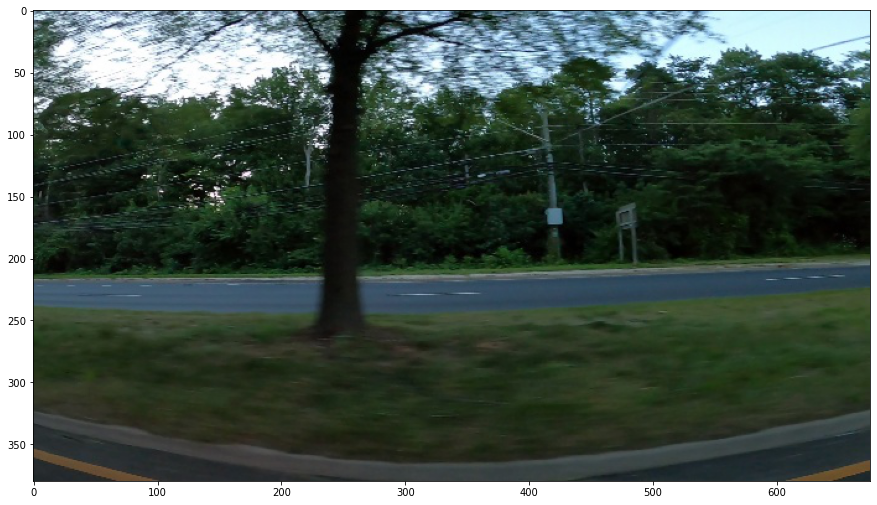

Running inference for /content/data/testing_images/vid_5_29480.jpg... Done


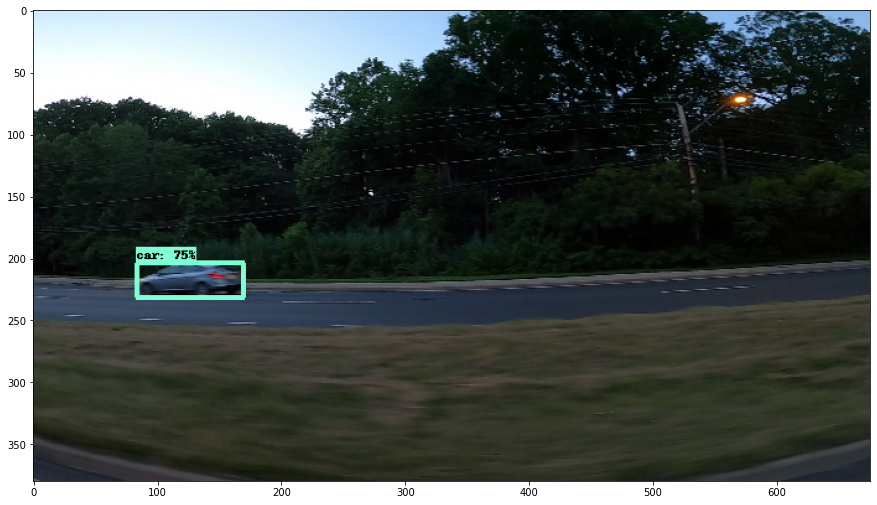

In [ ]:
import random as rand
for i in range(10):
  index = rand.randint(0, len(IMAGE_PATHS)-1)
  detect_objects(IMAGE_PATHS[index])

In [25]:
IMAGE_PATHS = []
for dirname, _, filenames in os.walk('/content/data/training_images'):
    for filename in filenames:
        IMAGE_PATHS.append((os.path.join(dirname, filename)))
IMAGE_PATHS

['/content/data/training_images/vid_4_7340.jpg',
 '/content/data/training_images/vid_4_2420.jpg',
 '/content/data/training_images/vid_4_19800.jpg',
 '/content/data/training_images/vid_4_16640.jpg',
 '/content/data/training_images/vid_4_14460.jpg',
 '/content/data/training_images/vid_4_20020.jpg',
 '/content/data/training_images/vid_4_9000.jpg',
 '/content/data/training_images/vid_4_13860.jpg',
 '/content/data/training_images/vid_4_22620.jpg',
 '/content/data/training_images/vid_4_12200.jpg',
 '/content/data/training_images/vid_4_10620.jpg',
 '/content/data/training_images/vid_4_22160.jpg',
 '/content/data/training_images/vid_4_21960.jpg',
 '/content/data/training_images/vid_4_12320.jpg',
 '/content/data/training_images/vid_4_10680.jpg',
 '/content/data/training_images/vid_4_6360.jpg',
 '/content/data/training_images/vid_4_12720.jpg',
 '/content/data/training_images/vid_4_22800.jpg',
 '/content/data/training_images/vid_4_4420.jpg',
 '/content/data/training_images/vid_4_2400.jpg',
 '/con

Running inference for /content/data/training_images/vid_4_11900.jpg... Done


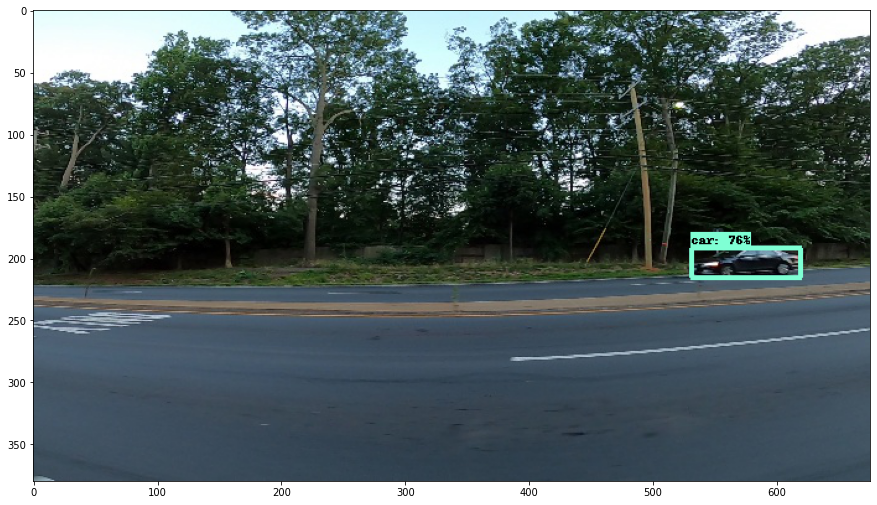

Running inference for /content/data/training_images/vid_4_21160.jpg... Done


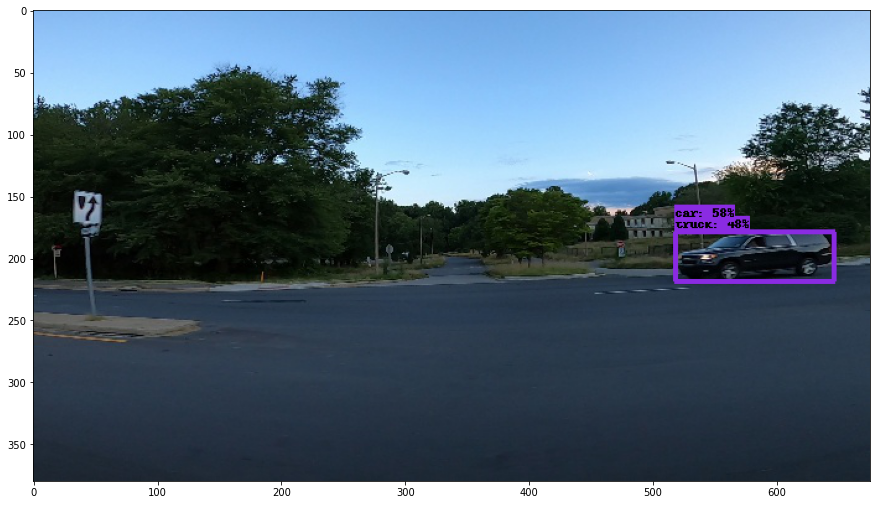

Running inference for /content/data/training_images/vid_4_18700.jpg... Done


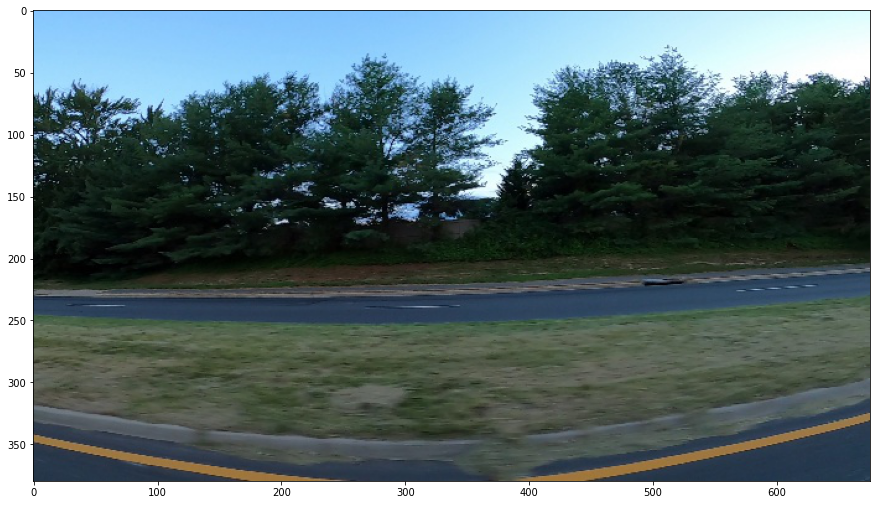

Running inference for /content/data/training_images/vid_4_18820.jpg... Done


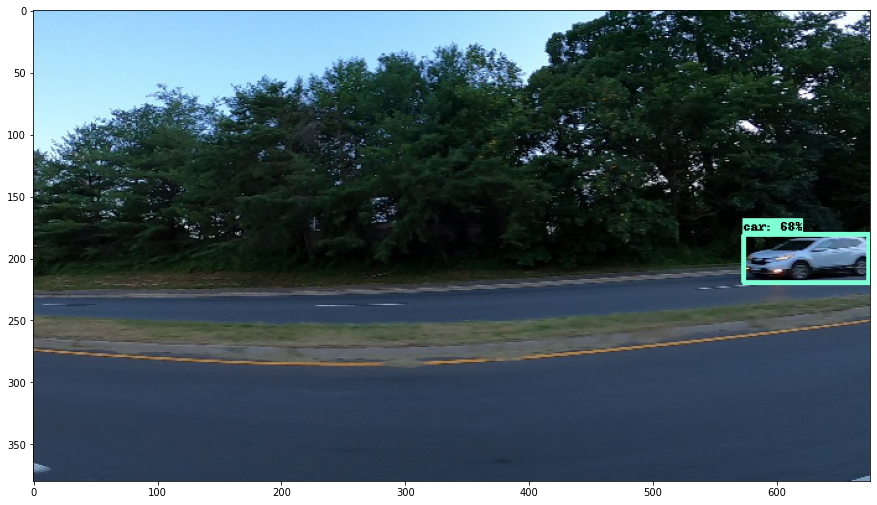

Running inference for /content/data/training_images/vid_4_16000.jpg... Done


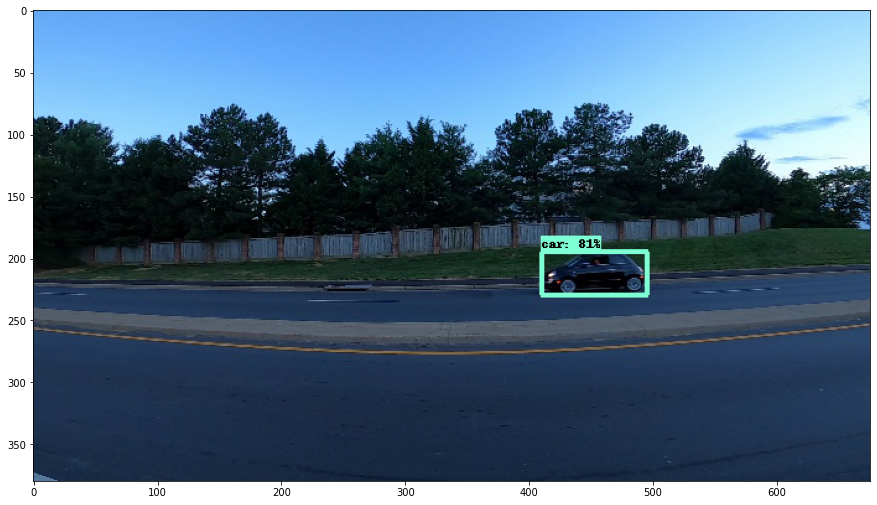

Running inference for /content/data/training_images/vid_4_2080.jpg... Done


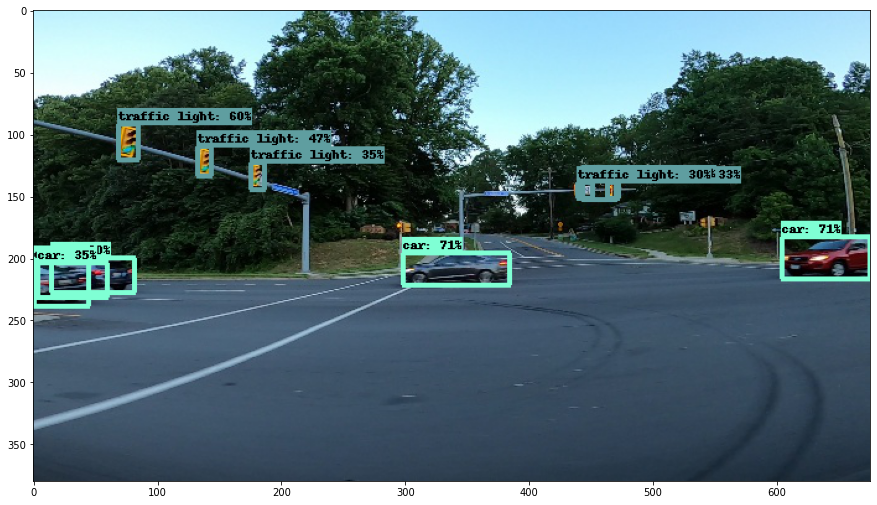

Running inference for /content/data/training_images/vid_4_3400.jpg... Done


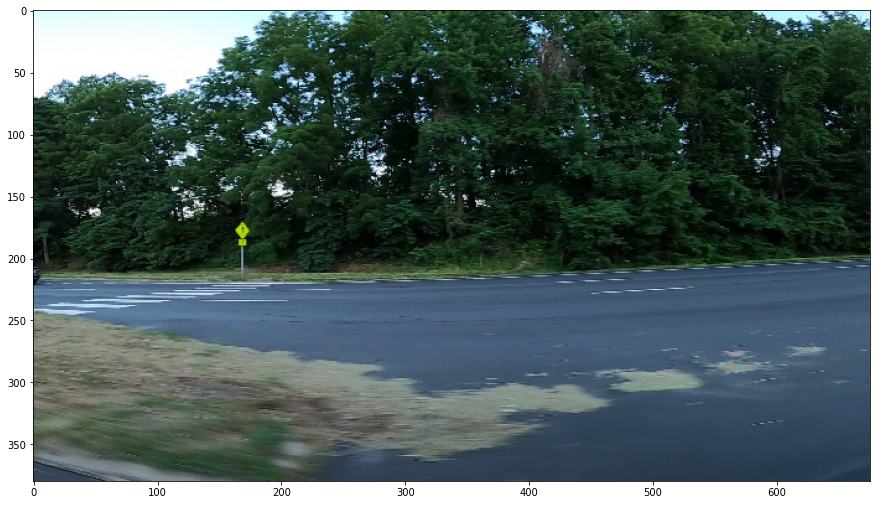

Running inference for /content/data/training_images/vid_4_23240.jpg... Done


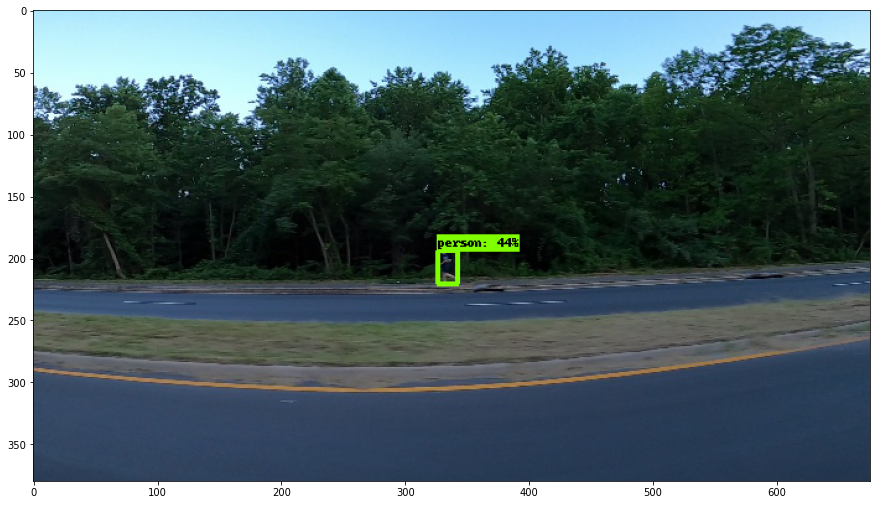

Running inference for /content/data/training_images/vid_4_1800.jpg... Done


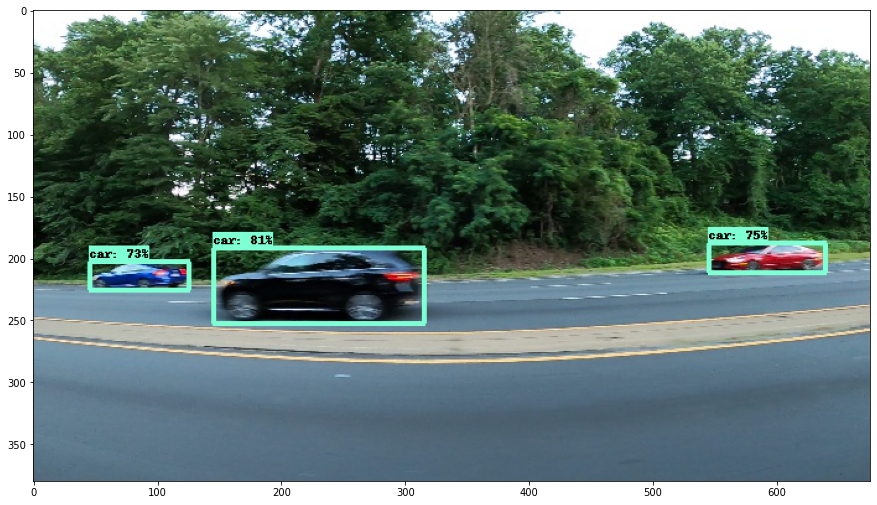

Running inference for /content/data/training_images/vid_4_24880.jpg... Done


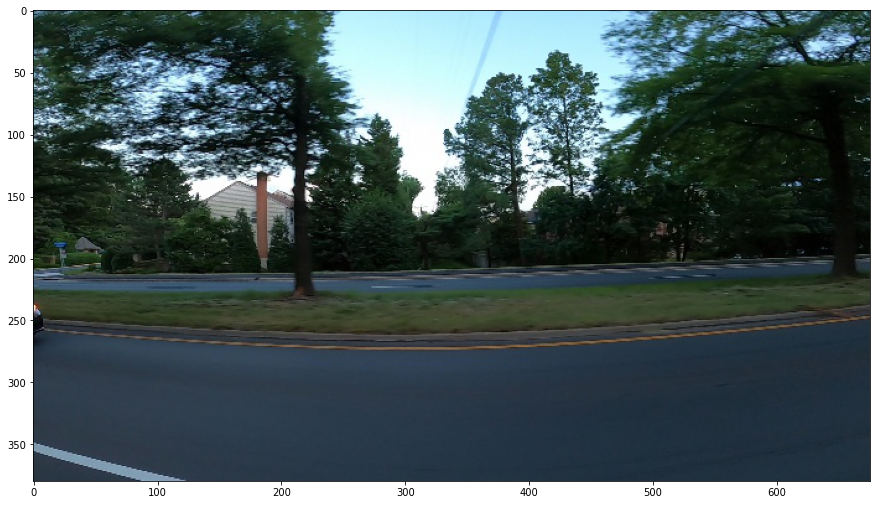

In [26]:
import random as rand
for i in range(10):
  index = rand.randint(0, len(IMAGE_PATHS)-1)
  detect_objects(IMAGE_PATHS[index])

In [27]:
!unzip "/content/archive.zip"

Archive:  /content/archive.zip
  inflating: Vehicle Detection/1.jpg  
  inflating: Vehicle Detection/1.txt  
  inflating: Vehicle Detection/10.jpg  
  inflating: Vehicle Detection/10.txt  
  inflating: Vehicle Detection/100.jpg  
  inflating: Vehicle Detection/100.txt  
  inflating: Vehicle Detection/101.jpg  
  inflating: Vehicle Detection/101.txt  
  inflating: Vehicle Detection/102.jpg  
  inflating: Vehicle Detection/102.txt  
  inflating: Vehicle Detection/103.jpg  
  inflating: Vehicle Detection/103.txt  
  inflating: Vehicle Detection/104.jpg  
  inflating: Vehicle Detection/104.txt  
  inflating: Vehicle Detection/105.jpg  
  inflating: Vehicle Detection/105.txt  
  inflating: Vehicle Detection/106.jpg  
  inflating: Vehicle Detection/106.txt  
  inflating: Vehicle Detection/107.jpg  
  inflating: Vehicle Detection/107.txt  
  inflating: Vehicle Detection/108.jpg  
  inflating: Vehicle Detection/108.txt  
  inflating: Vehicle Detection/109.jpg  
  inflating: Vehicle Detection/1

In [28]:
IMAGE_PATHS = []
for dirname, _, filenames in os.walk('/content/Vehicle Detection'):
    for filename in filenames:
      if "jpg" in filename:
        IMAGE_PATHS.append((os.path.join(dirname, filename)))
IMAGE_PATHS

['/content/Vehicle Detection/269.jpg',
 '/content/Vehicle Detection/141.jpg',
 '/content/Vehicle Detection/326.jpg',
 '/content/Vehicle Detection/136.jpg',
 '/content/Vehicle Detection/212.jpg',
 '/content/Vehicle Detection/104.jpg',
 '/content/Vehicle Detection/2739.jpg',
 '/content/Vehicle Detection/2779.jpg',
 '/content/Vehicle Detection/2660.jpg',
 '/content/Vehicle Detection/150.jpg',
 '/content/Vehicle Detection/268.jpg',
 '/content/Vehicle Detection/982.jpg',
 '/content/Vehicle Detection/2855.jpg',
 '/content/Vehicle Detection/2921.jpg',
 '/content/Vehicle Detection/11.jpg',
 '/content/Vehicle Detection/115.jpg',
 '/content/Vehicle Detection/231.jpg',
 '/content/Vehicle Detection/2851.jpg',
 '/content/Vehicle Detection/156.jpg',
 '/content/Vehicle Detection/957.jpg',
 '/content/Vehicle Detection/303.jpg',
 '/content/Vehicle Detection/2845.jpg',
 '/content/Vehicle Detection/2840.jpg',
 '/content/Vehicle Detection/1646.jpg',
 '/content/Vehicle Detection/2666.jpg',
 '/content/Vehic

Running inference for /content/Vehicle Detection/1508.jpg... Done


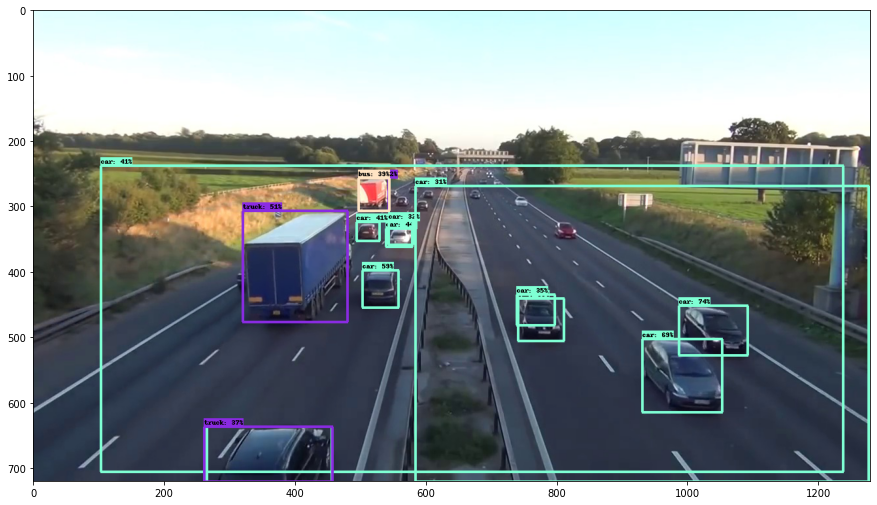

Running inference for /content/Vehicle Detection/349.jpg... Done


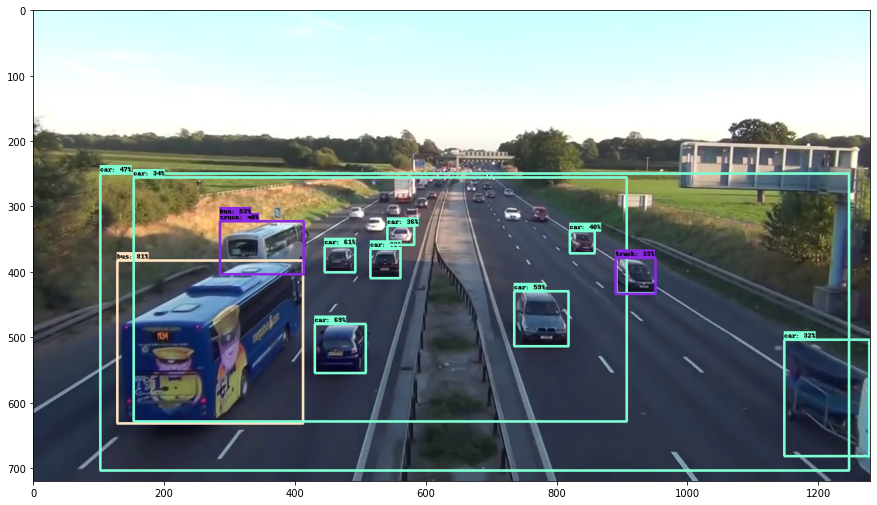

Running inference for /content/Vehicle Detection/1694.jpg... Done


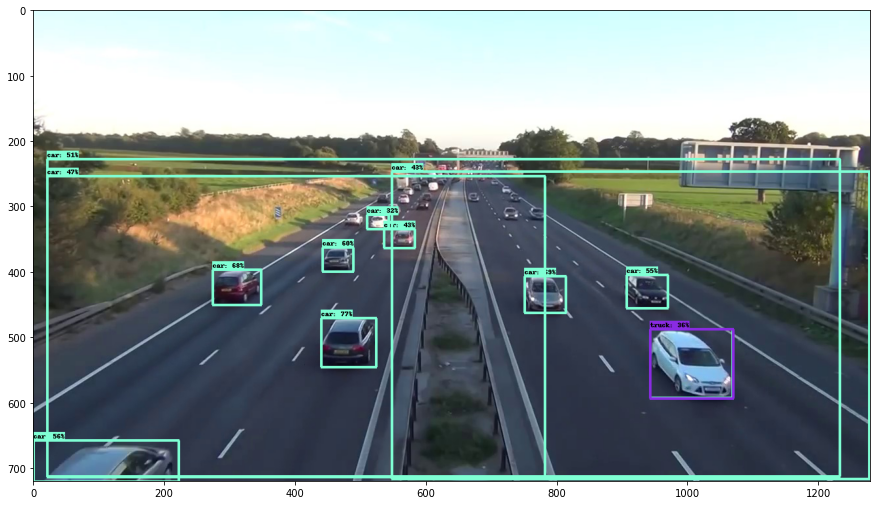

Running inference for /content/Vehicle Detection/2780.jpg... Done


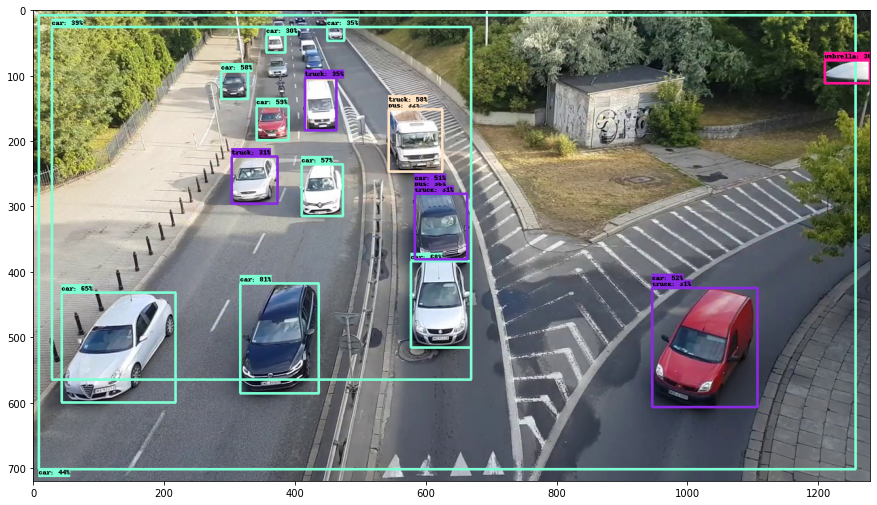

Running inference for /content/Vehicle Detection/2624.jpg... Done


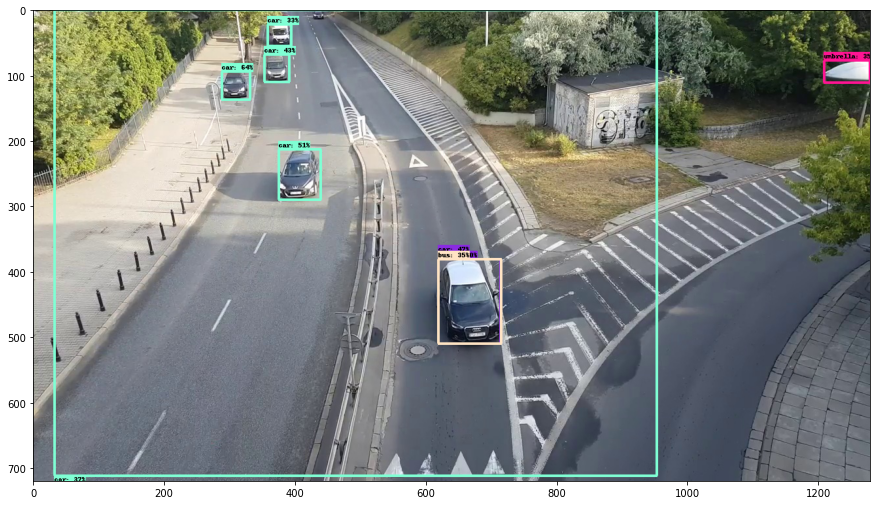

Running inference for /content/Vehicle Detection/527.jpg... Done


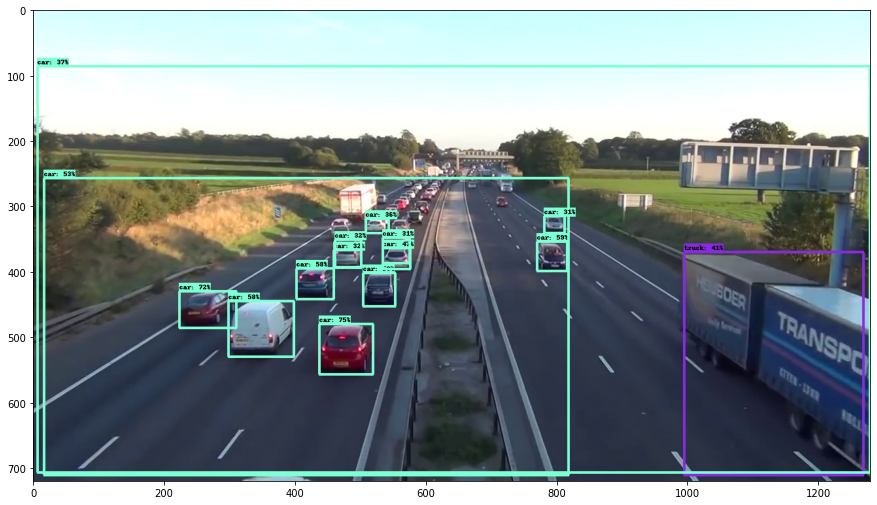

Running inference for /content/Vehicle Detection/246.jpg... Done


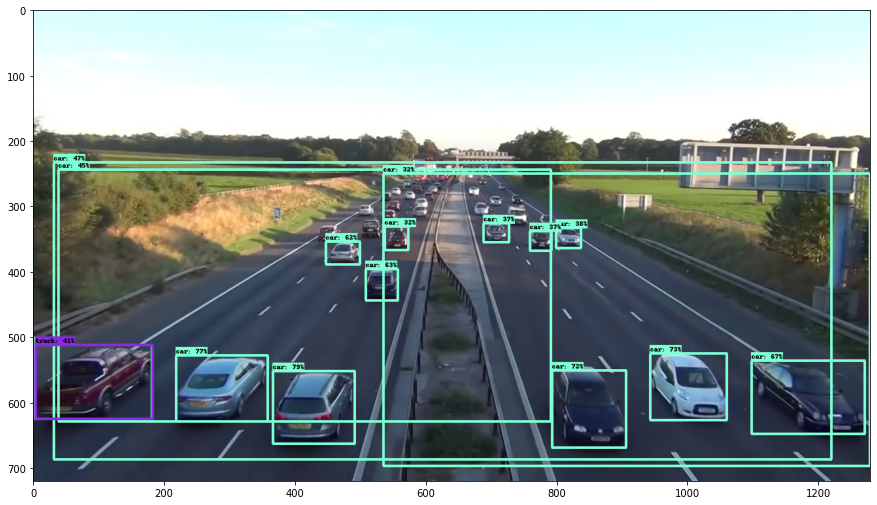

Running inference for /content/Vehicle Detection/3032.jpg... Done


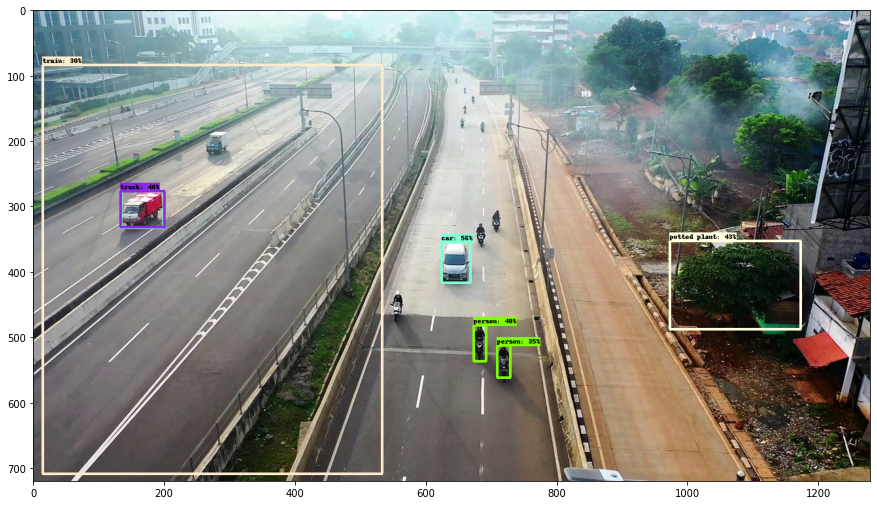

Running inference for /content/Vehicle Detection/2854.jpg... Done


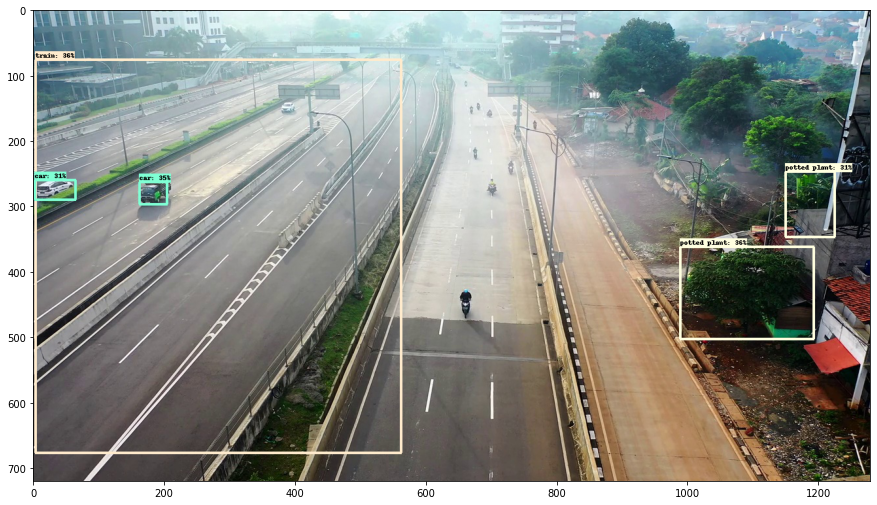

Running inference for /content/Vehicle Detection/279.jpg... Done


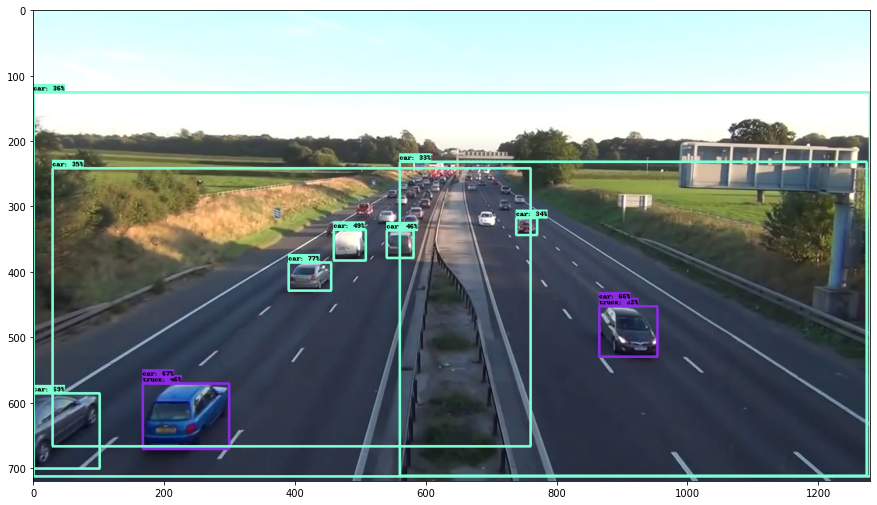

In [29]:
import random as rand
for i in range(10):
  index = rand.randint(0, len(IMAGE_PATHS)-1)
  detect_objects(IMAGE_PATHS[index])

Running inference for /content/Vehicle Detection/2685.jpg... Done


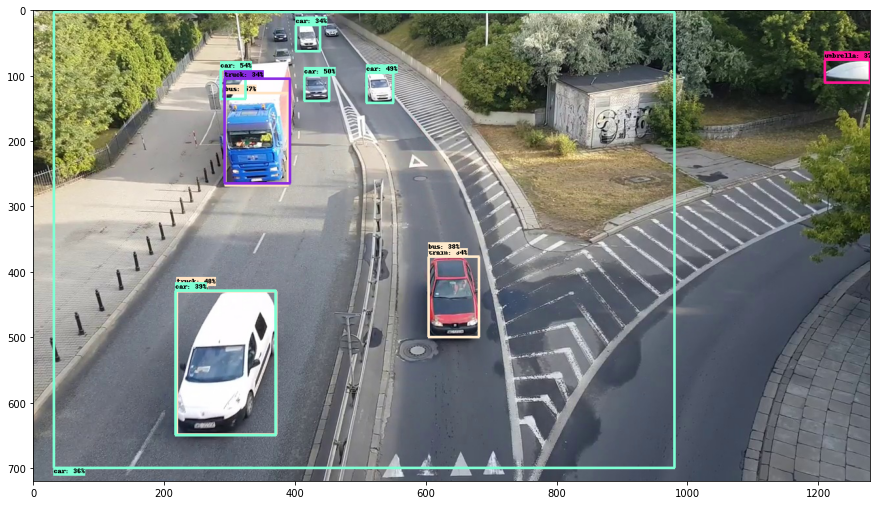

Running inference for /content/Vehicle Detection/1664.jpg... Done


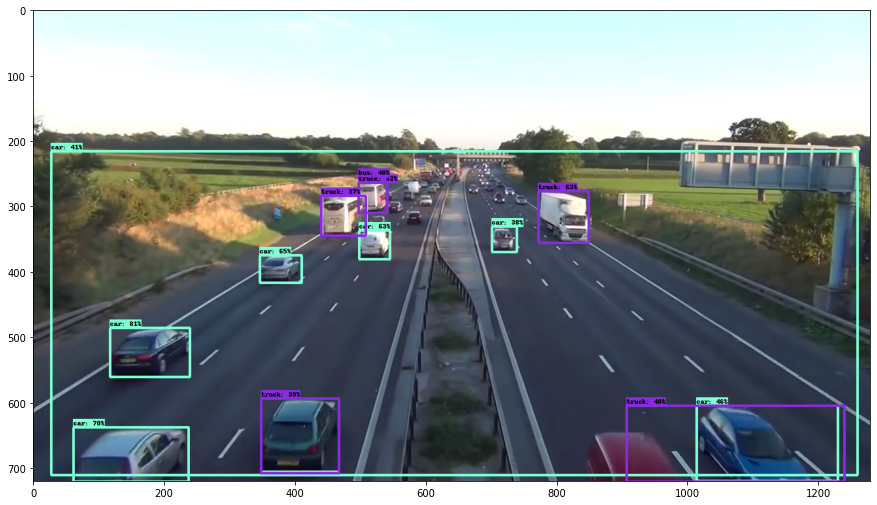

Running inference for /content/Vehicle Detection/220.jpg... Done


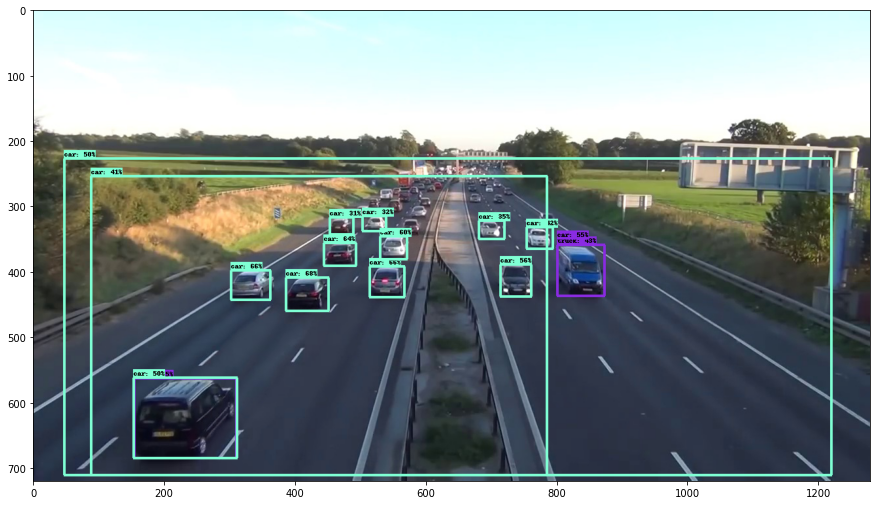

Running inference for /content/Vehicle Detection/2865.jpg... Done


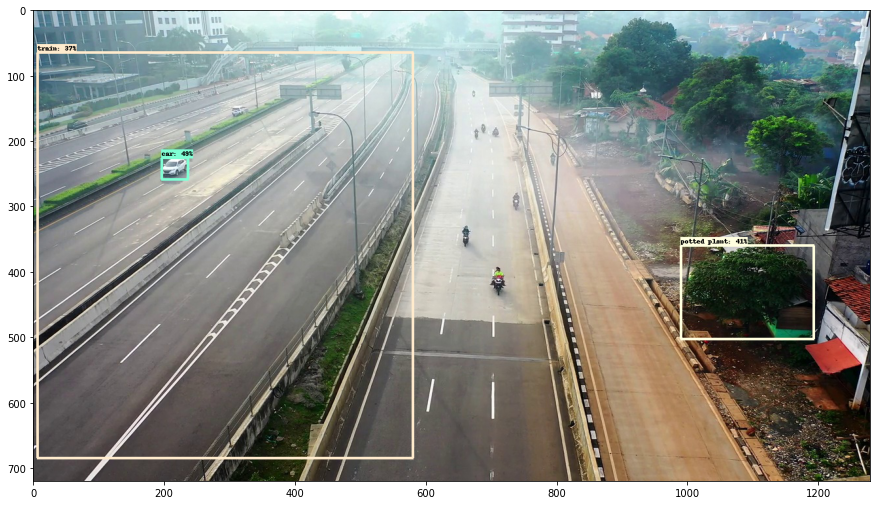

Running inference for /content/Vehicle Detection/2605.jpg... Done


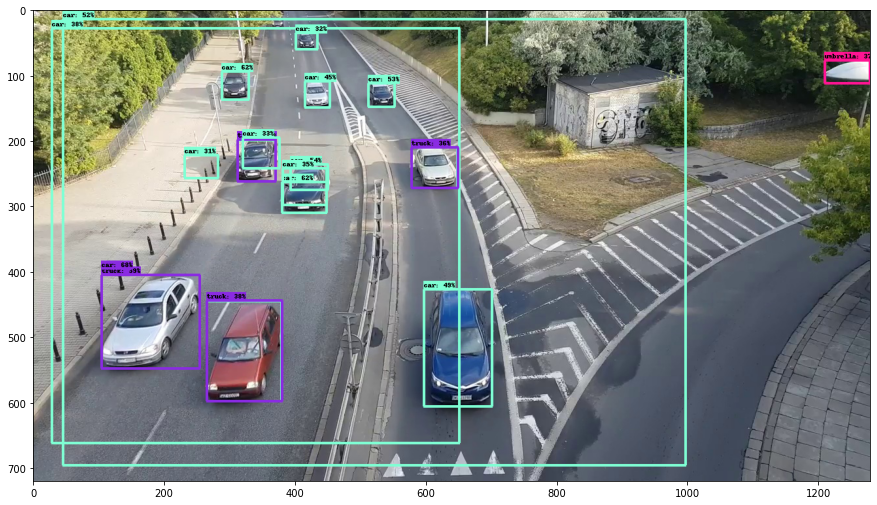

Running inference for /content/Vehicle Detection/391.jpg... Done


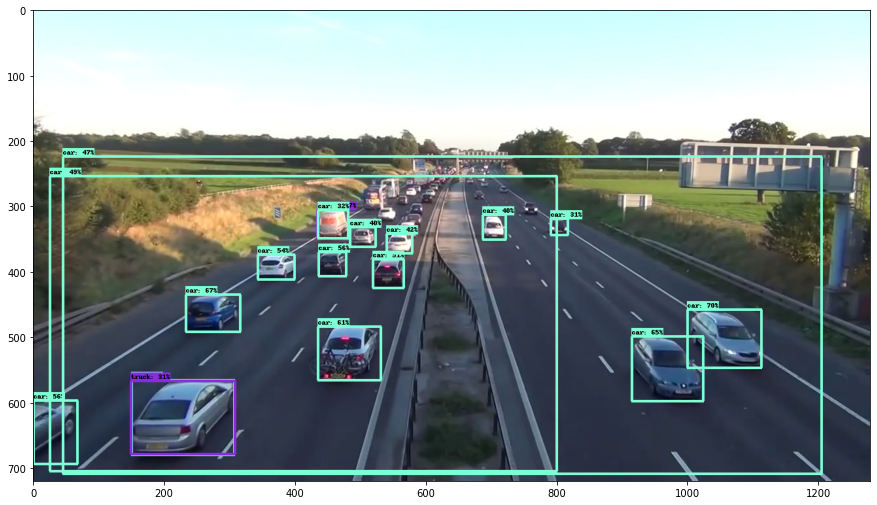

Running inference for /content/Vehicle Detection/87.jpg... Done


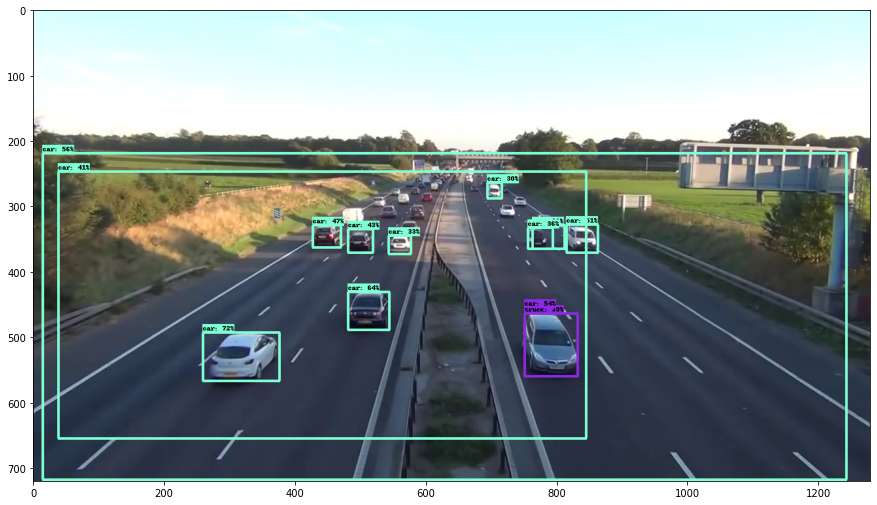

Running inference for /content/Vehicle Detection/194.jpg... Done


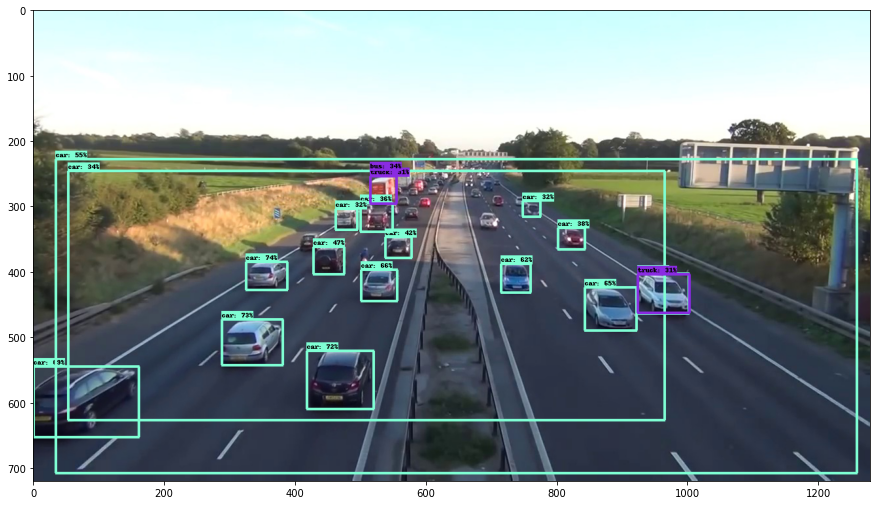

Running inference for /content/Vehicle Detection/1602.jpg... Done


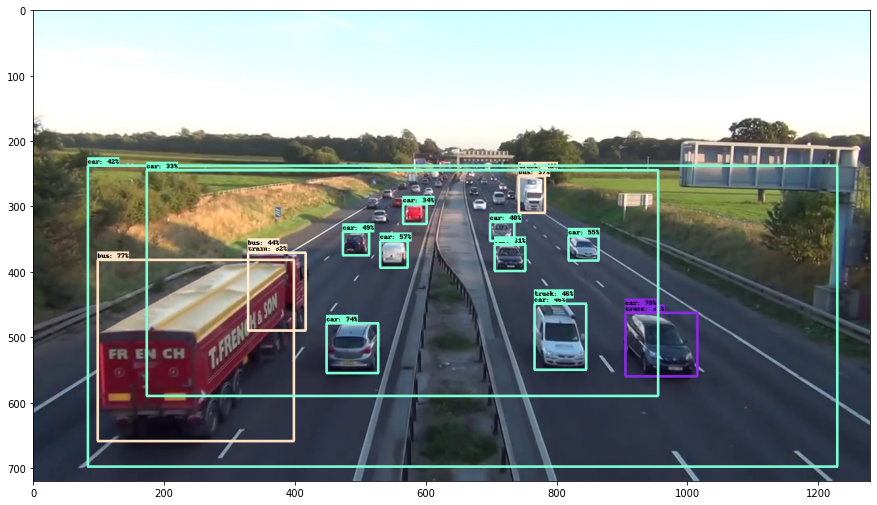

Running inference for /content/Vehicle Detection/651.jpg... Done


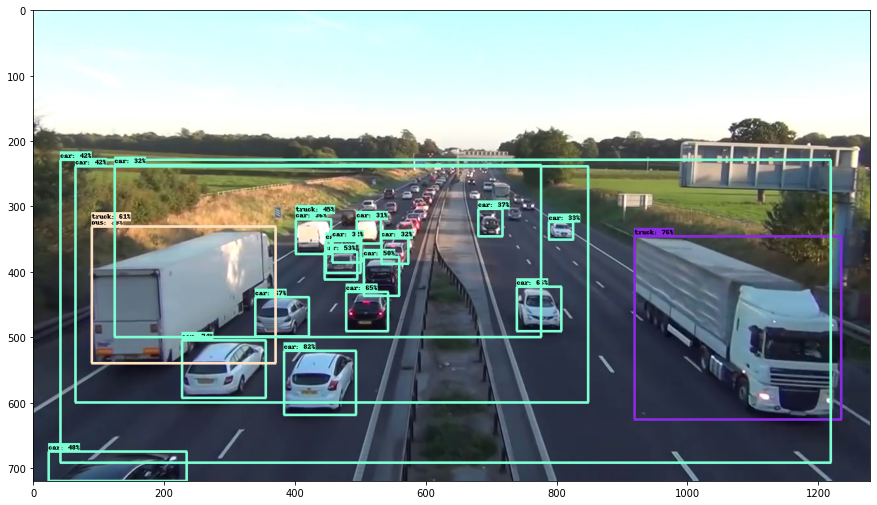

In [30]:
import random as rand
for i in range(10):
  index = rand.randint(0, len(IMAGE_PATHS)-1)
  detect_objects(IMAGE_PATHS[index])